In [1]:
import IJulia

# The julia kernel has built in support for Revise.jl, so this is the 
# recommended approach for long-running sessions:
# https://github.com/JuliaLang/IJulia.jl/blob/9b10fa9b879574bbf720f5285029e07758e50a5e/src/kernel.jl#L46-L51

# Users should enable revise within .julia/config/startup_ijulia.jl:
# https://timholy.github.io/Revise.jl/stable/config/#Using-Revise-automatically-within-Jupyter/IJulia-1

# clear console history
IJulia.clear_history()

fig_width = 10
fig_height = 5
fig_format = :retina
fig_dpi = 96

# no retina format type, use svg for high quality type/marks
if fig_format == :retina
  fig_format = :svg
elseif fig_format == :pdf
  fig_dpi = 96
  # Enable PDF support for IJulia
  IJulia.register_mime(MIME("application/pdf"))
end

# convert inches to pixels
fig_width = fig_width * fig_dpi
fig_height = fig_height * fig_dpi

# Intialize Plots w/ default fig width/height
try
  import Plots

  # Plots.jl doesn't support PDF output for versions < 1.28.1
  # so use png (if the DPI remains the default of 300 then set to 96)
  if (Plots._current_plots_version < v"1.28.1") & (fig_format == :pdf)
    Plots.gr(size=(fig_width, fig_height), fmt = :png, dpi = fig_dpi)
  else
    Plots.gr(size=(fig_width, fig_height), fmt = fig_format, dpi = fig_dpi)
  end
catch e
  # @warn "Plots init" exception=(e, catch_backtrace())
end

# Initialize CairoMakie with default fig width/height
try
  import CairoMakie
  
  CairoMakie.activate!(type = string(fig_format))
  CairoMakie.update_theme!(resolution=(fig_width, fig_height))
catch e
    # @warn "CairoMakie init" exception=(e, catch_backtrace())
end
  
# Set run_path if specified
try
  run_path = raw"/home/ludo/ownCloud/exposes/2023/MPDEE_CIRM/topo2"
  if !isempty(run_path)
    cd(run_path)
  end
catch e
  @warn "Run path init:" exception=(e, catch_backtrace())
end


# emulate old Pkg.installed beahvior, see
# https://discourse.julialang.org/t/how-to-use-pkg-dependencies-instead-of-pkg-installed/36416/9
import Pkg
function isinstalled(pkg::String)
  any(x -> x.name == pkg && x.is_direct_dep, values(Pkg.dependencies()))
end

# ojs_define
if isinstalled("JSON") && isinstalled("DataFrames")
  import JSON, DataFrames
  global function ojs_define(; kwargs...)
    convert(x) = x
    convert(x::DataFrames.AbstractDataFrame) = Tables.rows(x)
    content = Dict("contents" => [Dict("name" => k, "value" => convert(v)) for (k, v) in kwargs])
    tag = "<script type='ojs-define'>$(JSON.json(content))</script>"
    IJulia.display(MIME("text/html"), tag)
  end
elseif isinstalled("JSON")
  import JSON
  global function ojs_define(; kwargs...)
    content = Dict("contents" => [Dict("name" => k, "value" => v) for (k, v) in kwargs])
    tag = "<script type='ojs-define'>$(JSON.json(content))</script>"
    IJulia.display(MIME("text/html"), tag)
  end
else
  global function ojs_define(; kwargs...)
    @warn "JSON package not available. Please install the JSON.jl package to use ojs_define."
  end
end


# don't return kernel dependencies (b/c Revise should take care of dependencies)
nothing


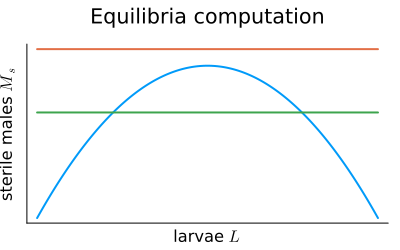

In [2]:
#| output: true

## parameters
β = 3. #6.
K = 1000.
v_L = 1/12.8
μ_L = -log(0.64)/12.8
m = 0.5
μ_M = 1/93.6
v_F = 1/1.5
μ_F = 1/79.5
M_S = 2500.

η0 = v_L * v_F * (1-m) * β / (μ_F * (μ_F + v_F)*(μ_L + v_L))

params_SIT = [β, K, v_L, μ_L, m, μ_M, v_F, μ_F, M_S]

function Lparabola(L, params, η0)
    β, K, v_L, μ_L, m, μ_M, v_F, μ_F, M_S = params

    return m*v_L/μ_M*L*(η0-1-η0*L/K)
end

Lplot = 0:.1:K*(1-1/η0)

Lpar = [Lparabola(L, params_SIT, η0) for L in Lplot]

using LaTeXStrings, Plots

plot(Lplot, [Lpar (0 .*Lplot.+8*10^4) (0 .*Lplot.+5*10^4)],
        linewidth = 2,
        title = "Equilibria computation\n ",
        legend = false,
        xlabel = "larvae "*L"L",
        ylabel = "sterile males "* L"M_s",
        size = (400, 250),
        ticks = false)

# max parabola m*v_L/(4*μ_M)*(η0-1)^2

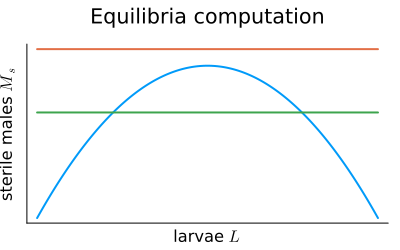

In [3]:
#| output: true
plot(Lplot, [Lpar (0 .*Lplot.+8*10^4) (0 .*Lplot.+5*10^4)],
        linewidth = 2,
        title = "Equilibria computation\n ",
        legend = false,
        xlabel = "larvae "*L"L",
        ylabel = "sterile males "* L"M_s",
        size = (400, 250),
        ticks = false)

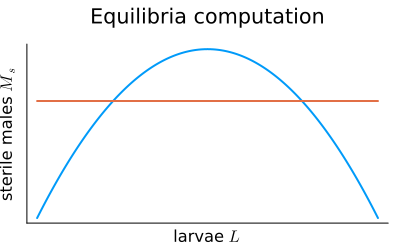

In [4]:
#| output: true
plot(Lplot, [Lpar (0 .*Lplot.+5*10^4)],
        linewidth = 2,
        title = "Equilibria computation\n ",
        legend = false,
        xlabel = "larvae "*L"L",
        ylabel = "sterile males "* L"M_s",
        size = (400, 250),
        ticks = false)

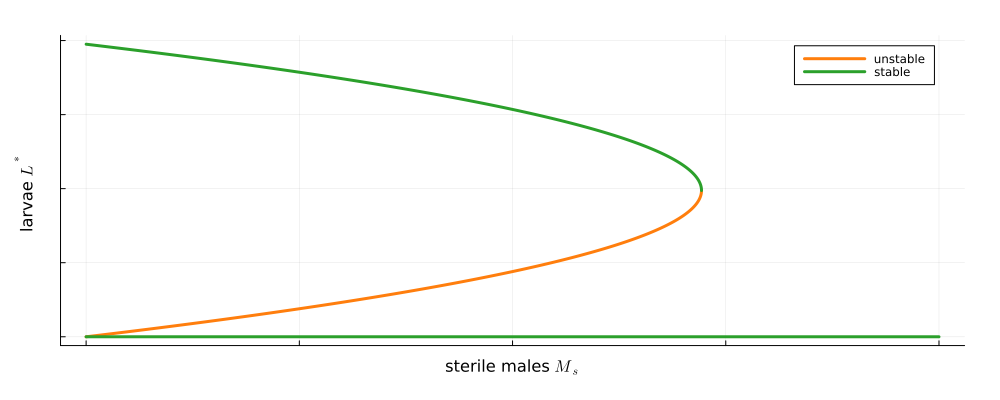

In [5]:
#| output: true

Lplot1 = 0:.1:K/2*(1-1/η0)
Lplot2 = K/2*(1-1/η0):.1:K*(1-1/η0)

Ms1 = [Lparabola(L, params_SIT, η0) for L in Lplot1]
Ms2 = [Lparabola(L, params_SIT, η0) for L in Lplot2]

colbifs = palette(:tab10)[3]
colbifu = palette(:tab10)[2]

plot([Ms1 Ms2], [Lplot1 Lplot2],
        linewidth = 3,
        label = ["unstable" "stable"],
        ylabel = "larvae "*L"L^*",
        xlabel = "sterile males "* L"M_s",
        color = [colbifu colbifs],
        formatter=Returns(""),
        margin = .7Plots.cm,
  	    size =(1000, 400))

Msplot = 0:100000

plot!(Msplot, (0 .* Msplot),
        primary = false,
        linewidth = 3,
        color = colbifs)

In [6]:
using DifferentialEquations, StaticArrays, DataFrames


function model_SIT(u, params, t)
    β, K, v_L, μ_L, m, μ_M, v_F, μ_F, M_S = params 	# unpacking parameters

    L = u[1] 						# unpacking state
    M = u[2]
    V = u[3]
    F = u[4]

    dL = β*(1-L/K)*F - (v_L+μ_L)*L 
    dM = m*v_L*L -μ_M*M 
    dV = (1-m)*v_L*L - v_F*V - μ_F*V
    dF = v_F*M/(M+M_S)*V - μ_F*F
  
    return @SVector [dL, dM, dV, dF]
end

## initial conditions
L0 = 110.0 # 0.0
M0 = 0.001
V0 = 0.0
F0 = 0.0 #10.0

state0 = @SVector [L0, M0, V0, F0]

## time
tmax = 350.
tspan = (0.0, tmax) 	# (start, end) as a tuple
step = 0.01

## integration
function int_SIT(model_SIT, state0, tspan, params_SIT, step)
    prob_SIT = ODEProblem(model_SIT, state0, tspan, params_SIT, saveat = step)

    sim_SIT = solve(prob_SIT, abstol=1e-6, reltol=1e-6)
    sim_SIT = DataFrame(sim_SIT)
    rename!(sim_SIT, :timestamp => :time, :value1 => :L, :value2 => :M, :value3 => :V, :value4 => :F)

    return sim_SIT
end

int_SIT (generic function with 1 method)

In [7]:
η0 

80.92561045034573

In [8]:
sim_SIT = int_SIT(model_SIT, state0, tspan, params_SIT, step)

state02 = @SVector [700., 0., 0., 0.]
sim_SIT2 = int_SIT(model_SIT, state02, tspan, params_SIT, step)

colors = palette(:tab10)[1:4]'

plot(sim_SIT.time, [sim_SIT.L sim_SIT.M sim_SIT.V sim_SIT.F], 
    color = colors,
    linewidth = 2,
    title = "\n SIT population dynamics",
    label = ["larvae " * L"L" "males " * L"M" "unmated females " * L"V" "mated females " * L"F"],  # latex strings, makrdown latex is off in labels
    ylabel = "population densities",
    xlabel = "time",
    margin = .5Plots.cm,
    topmargin = 1Plots.cm)

plot!(sim_SIT2.time, [sim_SIT2.L sim_SIT2.M sim_SIT2.V sim_SIT2.F], 
    color = colors,
    linewidth = 2,
    linestyle = :dash,
    primary = false)

In [9]:
#| output: true

p1 = plot([sim_SIT.time sim_SIT2.time], [sim_SIT.L sim_SIT2.L], lw=2, ylabel = "larvae "*L"L", label = ["persistence" "extinction"], legend = :right)
p3 = plot([sim_SIT.time sim_SIT2.time], [sim_SIT.M sim_SIT2.M], lw=2, ylabel = "males "*L"M", xlabel = "time", legend = false)
p2 = plot([sim_SIT.time sim_SIT2.time], [sim_SIT.V sim_SIT2.V], lw=2, ylabel="unmated females "*L"V", legend = false)
p4 = plot([sim_SIT.time sim_SIT2.time], [sim_SIT.F sim_SIT2.F], lw=2, ylabel = "mated females "*L"F", xlabel = "time", legend= false)

plot(p1, p2, p3, p4, layout=(2,2), formatter=Returns(""),    
    margin = .5Plots.cm)

In [10]:
#| output: true

M_S2 = 75000.

params_SIT2 = [β, K, v_L, μ_L, m, μ_M, v_F, μ_F, M_S2]


sim_SIT3 = int_SIT(model_SIT, state0, tspan, params_SIT2, step)
sim_SIT4 = int_SIT(model_SIT, state02, tspan, params_SIT2, step)

p1 = plot([sim_SIT3.time sim_SIT4.time], [sim_SIT3.L sim_SIT4.L], lw=2, ylabel = "larvae "*L"L", label = ["persistence" "extinction"], legend = :right)
p3 = plot([sim_SIT3.time sim_SIT4.time], [sim_SIT3.M sim_SIT4.M], lw=2, ylabel = "males "*L"M", xlabel = "time", legend = false)
p2 = plot([sim_SIT3.time sim_SIT4.time], [sim_SIT3.V sim_SIT4.V], lw=2, ylabel="unmated females "*L"V", legend = false)
p4 = plot([sim_SIT3.time sim_SIT4.time], [sim_SIT3.F sim_SIT4.F], lw=2, ylabel = "mated females "*L"F", xlabel = "time", legend= false)

plot(p1, p2, p3, p4, layout=(2,2), formatter=Returns(""),    
    margin = .5Plots.cm)

In [11]:
#| output: true

state03 = @SVector [0, M0, V0, 150]
state04 = @SVector [0, M0, V0, 10]

tspanb = (0.0, 4000) 

sim_SIT5 = int_SIT(model_SIT, state03, tspanb, params_SIT2, 10*step)
sim_SIT6 = int_SIT(model_SIT, state04, tspanb, params_SIT2, 10*step)

p1 = plot([sim_SIT5.time sim_SIT6.time], [sim_SIT5.L sim_SIT6.L], lw=2, ylabel = "larvae "*L"L", label = ["persistence" "extinction"], legend = :right)
p3 = plot([sim_SIT5.time sim_SIT6.time], [sim_SIT5.M sim_SIT6.M], lw=2, ylabel = "males "*L"M", xlabel = "time", legend = false)
p2 = plot([sim_SIT5.time sim_SIT6.time], [sim_SIT5.V sim_SIT6.V], lw=2, ylabel="unmated females "*L"V", legend = false)
p4 = plot([sim_SIT5.time sim_SIT6.time], [sim_SIT5.F sim_SIT6.F], lw=2, ylabel = "mated females "*L"F", xlabel = "time", legend= false)

plot(p1, p2, p3, p4, layout=(2,2), formatter=Returns(""),    
    margin = .5Plots.cm)

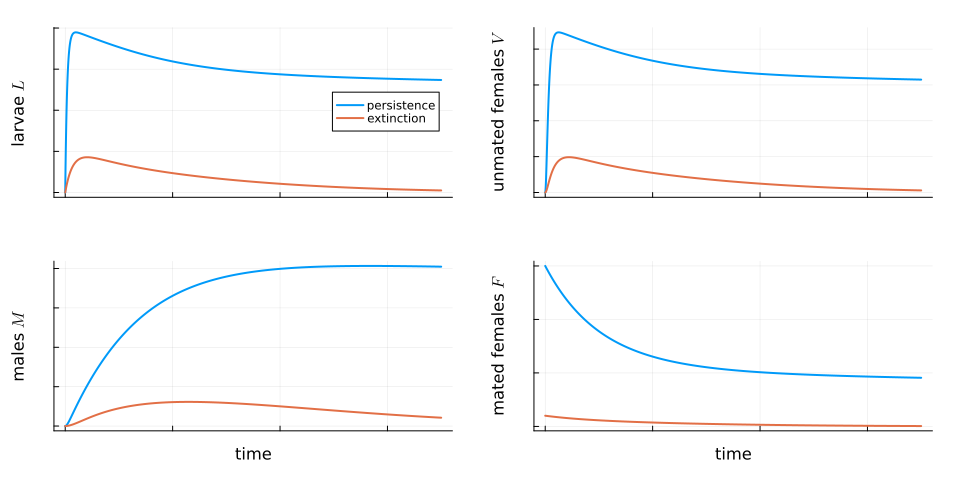

In [12]:
#| output: true

state03 = @SVector [0, M0, V0, 150]
state04 = @SVector [0, M0, V0, 10]

tspanb = (0.0, 350) 

sim_SIT5b = int_SIT(model_SIT, state03, tspanb, params_SIT2, 10*step)
sim_SIT6 = int_SIT(model_SIT, state04, tspanb, params_SIT2, 10*step)

p1 = plot([sim_SIT5b.time sim_SIT6.time], [sim_SIT5b.L sim_SIT6.L], lw=2, ylabel = "larvae "*L"L", label = ["persistence" "extinction"], legend = :right)
p3 = plot([sim_SIT5b.time sim_SIT6.time], [sim_SIT5b.M sim_SIT6.M], lw=2, ylabel = "males "*L"M", xlabel = "time", legend = false)
p2 = plot([sim_SIT5b.time sim_SIT6.time], [sim_SIT5b.V sim_SIT6.V], lw=2, ylabel="unmated females "*L"V", legend = false)
p4 = plot([sim_SIT5b.time sim_SIT6.time], [sim_SIT5b.F sim_SIT6.F], lw=2, ylabel = "mated females "*L"F", xlabel = "time", legend= false)

plot(p1, p2, p3, p4, layout=(2,2), formatter=Returns(""),    
    margin = .5Plots.cm)

In [13]:
#| output: true

scatter([sim_SIT5.L+sim_SIT5.V+sim_SIT5.M+sim_SIT5.F], [sim_SIT5.L], 
        ma=0.5, legend = false,
        xlabel = "total population "*L"L+V+M+F",
        ylabel = "larvae population "*L"L",
        margin = .5Plots.cm)

In [14]:
function model_SIT_Ms(u, params, t)
    β, K, v_L, μ_L, m, μ_M, v_F, μ_F, M_S = params 	# unpacking parameters

    L = u[1] 						# unpacking state
    M = u[2]
    V = u[3]
    F = u[4]
    Ms = u[5]

    dL = β*(1-L/K)*F - (v_L+μ_L)*L 
    dM = m*v_L*L -μ_M*M 
    dV = (1-m)*v_L*L - v_F*V - μ_F*V
    dF = v_F*M/(M+Ms)*V - μ_F*F
    dMs = - μ_M*Ms
  
    return @SVector [dL, dM, dV, dF, dMs]
end


## Ms release rate
α = 18

## release period T
T = 50.

## initial state


## integrate over a T period
function int_SIT_period(model, state0, tspan, params_SIT, step)

    prob_SIT_period = ODEProblem(model, state0, tspan, params_SIT, saveat = step)
    sim_SIT_period = solve(prob_SIT_period, abstol=1e-6, reltol=1e-6,saveat = step)
    
    return sim_SIT_period
end

## function for simulation of pulsed releases
function int_Ms_pulses(model, state0, params_SIT, step, α, T; early = false)

    store_sim = []

    tspan_period = (0., T)
    nmax = floor(tmax/T)
    L0, M0, V0, F0 = state0
    early || (state0_Ms = @SVector [L0, M0, V0, F0, 0])
    early && (state0_Ms = @SVector [L0, M0, V0, F0, α*T])

    state0_loop = state0_Ms

    for i in 1:nmax
        sim_period = int_SIT_period(model, state0_loop, 
                                    tspan_period, params_SIT, step)

        push!(store_sim, sim_period)
        
        state0_loop = last(sim_period) + [0, 0, 0, 0, α*T]
        tspan_period = tspan_period .+ T
    end

    ## on réunit tout dans une DF
    sol_pulse = DataFrame(store_sim[1])

    for i in 2:Int(nmax)
        append!(sol_pulse, DataFrame(store_sim[i]))
    end

    rename!(sol_pulse, :timestamp => :time, :value1 => :L, :value2 => :M, 
            :value3 => :V, :value4 => :F, :value5 => :Ms)

    return sol_pulse
end

## simulate for pulsed releases
sol_pulse = int_Ms_pulses(model_SIT_Ms, state0, params_SIT, step, α, 50)

# graphe
plot(sol_pulse.time, [sol_pulse.L sol_pulse.M sol_pulse.V sol_pulse.F sol_pulse.Ms], 
    palette = :tab10,
    linewidth = 2,
    title = "\n SIT population dynamics",
    label = ["larvae " * L"L" "males " * L"M" "unmated females " * L"V" "mated females " * L"F" "Sterile Males " * L"M_s"],  # latex strings, makrdown latex is off in labels
    ylabel = "population densities",
    xlabel = "time",
    margin = .5Plots.cm,
    topmargin = 1Plots.cm )

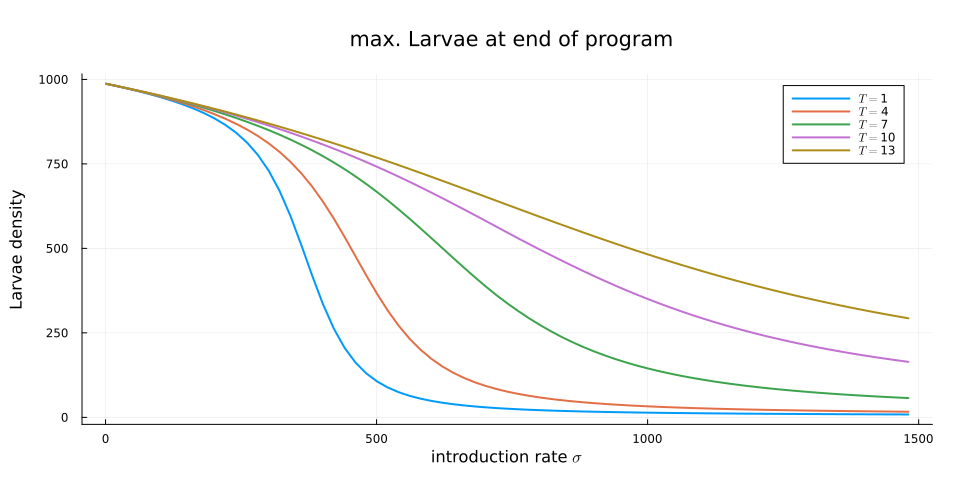

In [15]:
#| output: true



# alpharange = 1:1:800
alpharange = 1:20:1500
Trange = 1:3:13

function larvaend(model, state0, tspan, params_SIT, step = step, T = T; early = false)
    maxL = []

    for α in alpharange
        sol_pulse = int_Ms_pulses(model, state0, params_SIT, step, α, T; early = early)

        maxL = push!(maxL, maximum(sol_pulse[sol_pulse.time .> tmax - T, :L]))
    end

    return maxL
end

maxLT = DataFrame()

i=1 
for T in Trange
    maxL = larvaend(model_SIT_Ms, state04, tspan, params_SIT, step , T; early = false)
    maxLT[!, "$i"] = maxL
    i+=1
end

plot(alpharange, [maxLT[:, i] for i in 1:ncol(maxLT)],
    linewidth = 2,
    title = "\n max. Larvae at end of program",
    label = [L"T="*"$T" for T in Trange'],  # latex strings, makrdown latex is off in labels
    ylabel = "Larvae density",
    xlabel = "introduction rate "*L"\sigma",
    margin = .5Plots.cm,
    topmargin = 1Plots.cm)

# maxLT

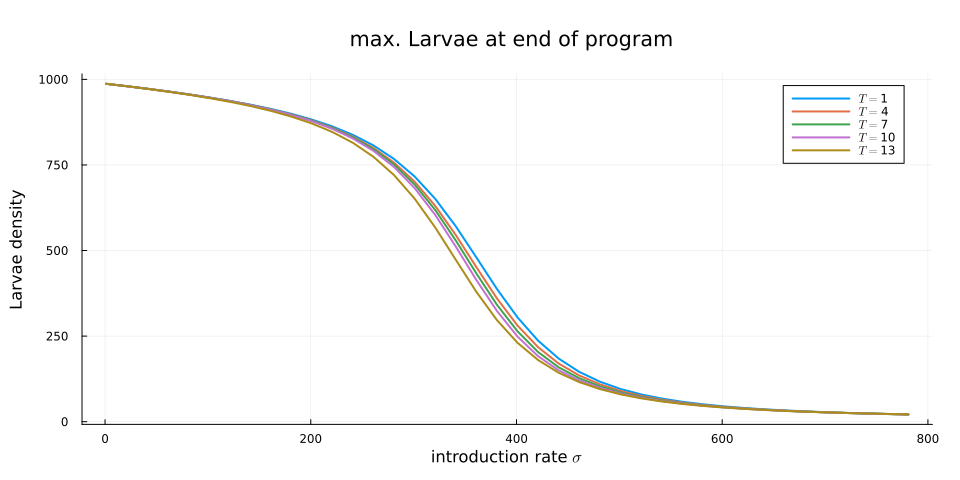

In [16]:
#| output: true

# alpharange = 1:.1:80
alpharange = 1:20:800
Trange = 1:3:13

maxLT2 = DataFrame()

i=1 
for T in Trange
    maxL = larvaend(model_SIT_Ms, state04, tspan, params_SIT, step , T; early = true)
    maxLT2[!, "$i"] = maxL
    i+=1
end


plot(alpharange, [maxLT2[:, i] for i in 1:ncol(maxLT2)],
    linewidth = 2,
    title = "\n max. Larvae at end of program",
    label = [L"T="*"$T" for T in Trange'],  # latex strings, makrdown latex is off in labels
    ylabel = "Larvae density",
    xlabel = "introduction rate "*L"\sigma",
    margin = .5Plots.cm,
    topmargin = 1Plots.cm)